<a href="https://colab.research.google.com/github/Nensi7/heart_disease_prediction/blob/main/Copy_of_heart_disease_prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
 from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
os.listdir('/content')

['.config', 'drive', 'sample_data']

In [ ]:
from google.colab import files
files.upload()


Saving heart_disease_health_indicators_BRFSS2015.csv to heart_disease_health_indicators_BRFSS2015 (1).csv


{'heart_disease_health_indicators_BRFSS2015 (1).csv': b'HeartDiseaseorAttack,HighBP,HighChol,CholCheck,BMI,Smoker,Stroke,Diabetes,PhysActivity,Fruits,Veggies,HvyAlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income\n0.0,1.0,1.0,1.0,40.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,5.0,18.0,15.0,1.0,0.0,9.0,4.0,3.0\n0.0,0.0,0.0,0.0,25.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,3.0,0.0,0.0,0.0,0.0,7.0,6.0,1.0\n0.0,1.0,1.0,1.0,28.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,5.0,30.0,30.0,1.0,0.0,9.0,4.0,8.0\n0.0,1.0,0.0,1.0,27.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,2.0,0.0,0.0,0.0,0.0,11.0,3.0,6.0\n0.0,1.0,1.0,1.0,24.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,2.0,3.0,0.0,0.0,0.0,11.0,5.0,4.0\n0.0,1.0,1.0,1.0,25.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,2.0,0.0,2.0,0.0,1.0,10.0,6.0,8.0\n0.0,1.0,0.0,1.0,30.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,3.0,0.0,14.0,0.0,0.0,9.0,6.0,7.0\n0.0,1.0,1.0,1.0,25.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,3.0,0.0,0.0,1.0,0.0,11.0,4.0,4.0\n1.0,1.0,

In [ ]:
!pip install scikit-learn matplotlib seaborn


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, precision_score, recall_score, f1_score



**STEP 1 : PREPROCESSING**

1. Import libraries & load dataset

In [ ]:
import pandas as pd
import numpy as np

# Load the dataset
df = pd.read_csv('heart_disease_health_indicators_BRFSS2015.csv')

# Display basic info
print("Dataset shape:", df.shape)
df.head()


Dataset shape: (253680, 22)


,HeartDiseaseorAttack,HighBP,HighChol,CholCheck,BMI,Smoker,Stroke,Diabetes,PhysActivity,Fruits,...,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income
0,0.0,1.0,1.0,1.0,40.0,1.0,0.0,0.0,0.0,0.0,...,1.0,0.0,5.0,18.0,15.0,1.0,0.0,9.0,4.0,3.0
1,0.0,0.0,0.0,0.0,25.0,1.0,0.0,0.0,1.0,0.0,...,0.0,1.0,3.0,0.0,0.0,0.0,0.0,7.0,6.0,1.0
2,0.0,1.0,1.0,1.0,28.0,0.0,0.0,0.0,0.0,1.0,...,1.0,1.0,5.0,30.0,30.0,1.0,0.0,9.0,4.0,8.0
3,0.0,1.0,0.0,1.0,27.0,0.0,0.0,0.0,1.0,1.0,...,1.0,0.0,2.0,0.0,0.0,0.0,0.0,11.0,3.0,6.0
4,0.0,1.0,1.0,1.0,24.0,0.0,0.0,0.0,1.0,1.0,...,1.0,0.0,2.0,3.0,0.0,0.0,0.0,11.0,5.0,4.0


 2. Understand data types & check for null values

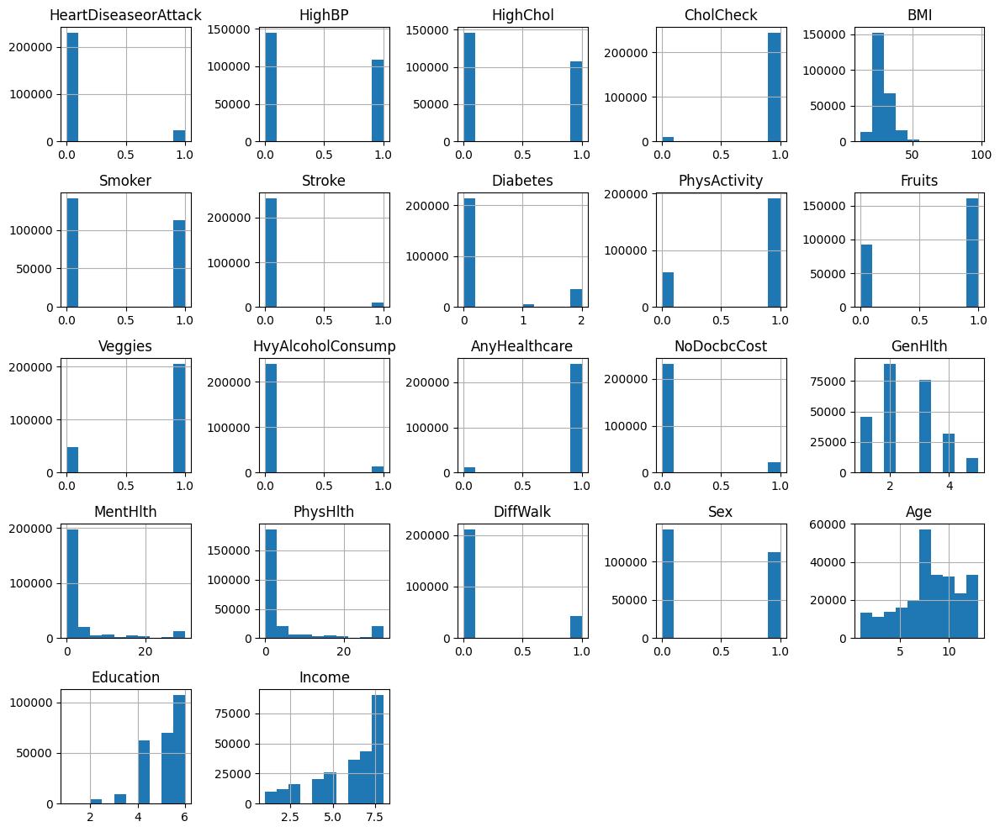

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Histogram of all numeric columns
df.hist(figsize=(12, 10))
plt.tight_layout()
plt.show()



In [ ]:
# Overview of numeric columns
df.describe()

,HeartDiseaseorAttack,HighBP,HighChol,CholCheck,BMI,Smoker,Stroke,Diabetes,PhysActivity,Fruits,...,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income
count,253680.000000,253680.000000,253680.000000,253680.000000,253680.000000,253680.000000,253680.000000,253680.000000,253680.000000,253680.000000,...,253680.000000,253680.000000,253680.000000,253680.000000,253680.000000,253680.000000,253680.000000,253680.000000,253680.000000,253680.000000
mean,0.094186,0.429001,0.424121,0.962670,28.382364,0.443169,0.040571,0.296921,0.756544,0.634256,...,0.951053,0.084177,2.511392,3.184772,4.242081,0.168224,0.440342,8.032119,5.050434,6.053875
std,0.292087,0.494934,0.494210,0.189571,6.608694,0.496761,0.197294,0.698160,0.429169,0.481639,...,0.215759,0.277654,1.068477,7.412847,8.717951,0.374066,0.496429,3.054220,0.985774,2.071148
min,0.000000,0.000000,0.000000,0.000000,12.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000
25%,0.000000,0.000000,0.000000,1.000000,24.000000,0.000000,0.000000,0.000000,1.000000,0.000000,...,1.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000,6.000000,4.000000,5.000000
50%,0.000000,0.000000,0.000000,1.000000,27.000000,0.000000,0.000000,0.000000,1.000000,1.000000,...,1.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000,8.000000,5.000000,7.000000
75%,0.000000,1.000000,1.000000,1.000000,31.000000,1.000000,0.000000,0.000000,1.000000,1.000000,...,1.000000,0.000000,3.000000,2.000000,3.000000,0.000000,1.000000,10.000000,6.000000,8.000000
max,1.000000,1.000000,1.000000,1.000000,98.000000,1.000000,1.000000,2.000000,1.000000,1.000000,...,1.000000,1.000000,5.000000,30.000000,30.000000,1.000000,1.000000,13.000000,6.000000,8.000000


In [ ]:
# Check data types of all columns
print("\nData Types:")
print(df.dtypes)

# Check for missing values
print("\nMissing Values:")
print(df.isnull().sum())



Data Types:
HeartDiseaseorAttack    float64
HighBP                  float64
HighChol                float64
CholCheck               float64
BMI                     float64
Smoker                  float64
Stroke                  float64
Diabetes                float64
PhysActivity            float64
Fruits                  float64
Veggies                 float64
HvyAlcoholConsump       float64
AnyHealthcare           float64
NoDocbcCost             float64
GenHlth                 float64
MentHlth                float64
PhysHlth                float64
DiffWalk                float64
Sex                     float64
Age                     float64
Education               float64
Income                  float64
dtype: object

Missing Values:
HeartDiseaseorAttack    0
HighBP                  0
HighChol                0
CholCheck               0
BMI                     0
Smoker                  0
Stroke                  0
Diabetes                0
PhysActivity            0
Fruits            

3. Check class balance for the target variable

In [ ]:
# Count of each class in target variable
print("\nTarget variable class distribution:")
print(df['HeartDiseaseorAttack'].value_counts())



Target variable class distribution:
HeartDiseaseorAttack
0.0    229787
1.0     23893
Name: count, dtype: int64


4. Check and drop duplicate rows (if any)

In [ ]:
# Check for duplicates
duplicate_rows = df.duplicated().sum()
print(f"\nDuplicate rows in dataset: {duplicate_rows}")

# Drop duplicates if present
df = df.drop_duplicates()
print("Shape after dropping duplicates:", df.shape)



Duplicate rows in dataset: 23899
Shape after dropping duplicates: (229781, 22)


5. Normalize/scale the numerical features

In [ ]:
from sklearn.preprocessing import StandardScaler

# Select features to scale
features_to_scale = ['BMI', 'MentHlth', 'PhysHlth']

scaler = StandardScaler()
df[features_to_scale] = scaler.fit_transform(df[features_to_scale])

print("\nScaled BMI, MentHlth, and PhysHlth columns.")
df[features_to_scale].head()



Scaled BMI, MentHlth, and PhysHlth columns.


,BMI,MentHlth,PhysHlth
0,1.667220,1.879074,1.141300
1,-0.543101,-0.454434,-0.516791
2,-0.101037,3.434746,2.799391
3,-0.248391,-0.454434,-0.516791
4,-0.690456,-0.065516,-0.516791


6. Check correlations

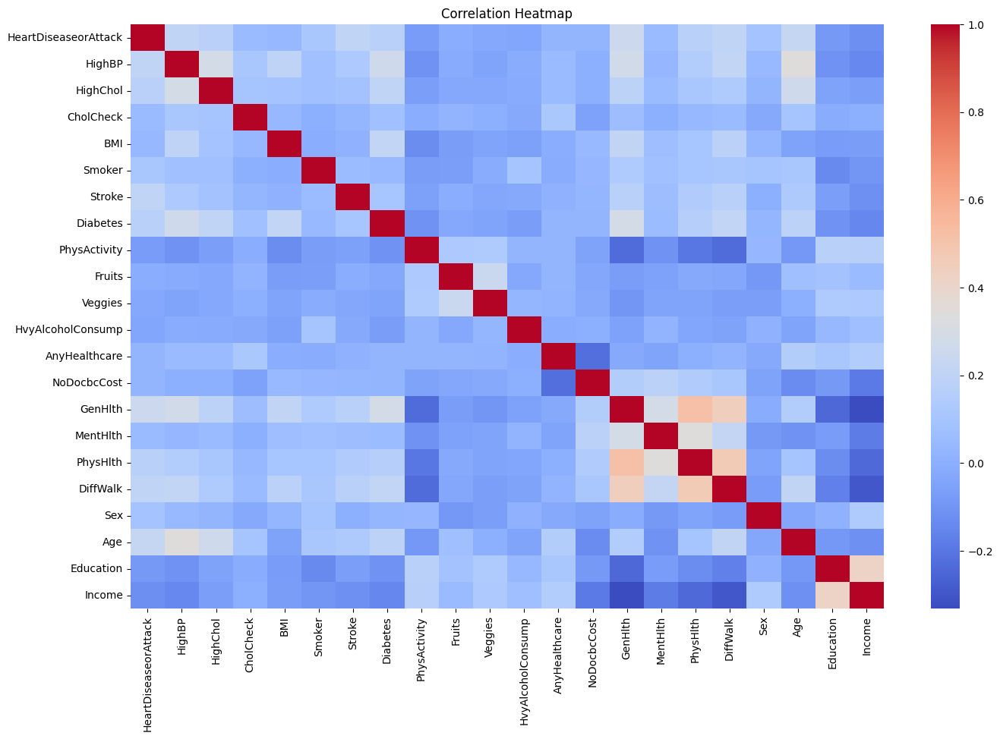

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Plot heatmap of feature correlation
plt.figure(figsize=(16,10))
sns.heatmap(df.corr(), annot=False, cmap='coolwarm')
plt.title('Correlation Heatmap')
plt.show()


**STEP 2 : MODEL TRAINING AND EVALUATION**

- LINEAR REGRESSION

Step 1: Split data into input (X) and target (y)

In [ ]:
from sklearn.model_selection import train_test_split

# Separate features and target
X = df.drop('HeartDiseaseorAttack', axis=1)
y = df['HeartDiseaseorAttack']

# Split into training and testing sets (80% train, 20% test)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print("Train set size:", X_train.shape)
print("Test set size:", X_test.shape)


Train set size: (183824, 21)
Test set size: (45957, 21)


 Step 2: Train a Logistic Regression model

In [ ]:
from sklearn.linear_model import LogisticRegression

# Initialize and train the model
model = LogisticRegression(max_iter=1000)
model.fit(X_train, y_train)

print("Model training completed.")


Model training completed.


Step 3: Evaluate model performance

In [ ]:
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

# Predict on test data
y_pred = model.predict(X_test)

# Evaluation metrics
accuracy = accuracy_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)
report = classification_report(y_test, y_pred)

print(f"Accuracy: {accuracy:.4f}")
print("\nConfusion Matrix:")
print(conf_matrix)
print("\nClassification Report:")
print(report)


Accuracy: 0.9004

Confusion Matrix:
[[40803   466]
 [ 4112   576]]

Classification Report:
              precision    recall  f1-score   support

         0.0       0.91      0.99      0.95     41269
         1.0       0.55      0.12      0.20      4688

    accuracy                           0.90     45957
   macro avg       0.73      0.56      0.57     45957
weighted avg       0.87      0.90      0.87     45957



Step 4: Visualize the confusion matrix

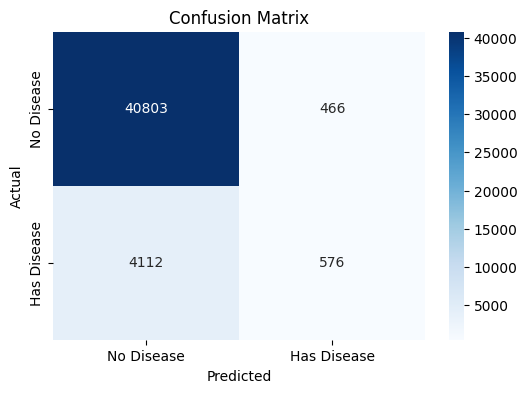

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(6,4))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=["No Disease", "Has Disease"], yticklabels=["No Disease", "Has Disease"])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()


- RANDOM FOREST

Step 1: Define X and y from DataFrame

In [ ]:
# Separate features and target
X = df.drop('HeartDiseaseorAttack', axis=1)
y = df['HeartDiseaseorAttack']


 Step 2: Train-test split

In [ ]:
from sklearn.model_selection import train_test_split

# Split the dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


Step 3: Train the Random Forest model

In [ ]:
from sklearn.ensemble import RandomForestClassifier

# Create and train model
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)


RandomForestClassifier(random_state=42)

Step 4: Predict and Evaluate

In [ ]:
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

# Predict on test data
rf_predictions = rf_model.predict(X_test)

# Evaluate
print("Accuracy:", accuracy_score(y_test, rf_predictions))
print("Confusion Matrix:\n", confusion_matrix(y_test, rf_predictions))
print("Classification Report:\n", classification_report(y_test, rf_predictions))


Accuracy: 0.8948364775768654
Confusion Matrix:
 [[40602   667]
 [ 4166   522]]
Classification Report:
               precision    recall  f1-score   support

         0.0       0.91      0.98      0.94     41269
         1.0       0.44      0.11      0.18      4688

    accuracy                           0.89     45957
   macro avg       0.67      0.55      0.56     45957
weighted avg       0.86      0.89      0.87     45957



Step 5: Feature Importance

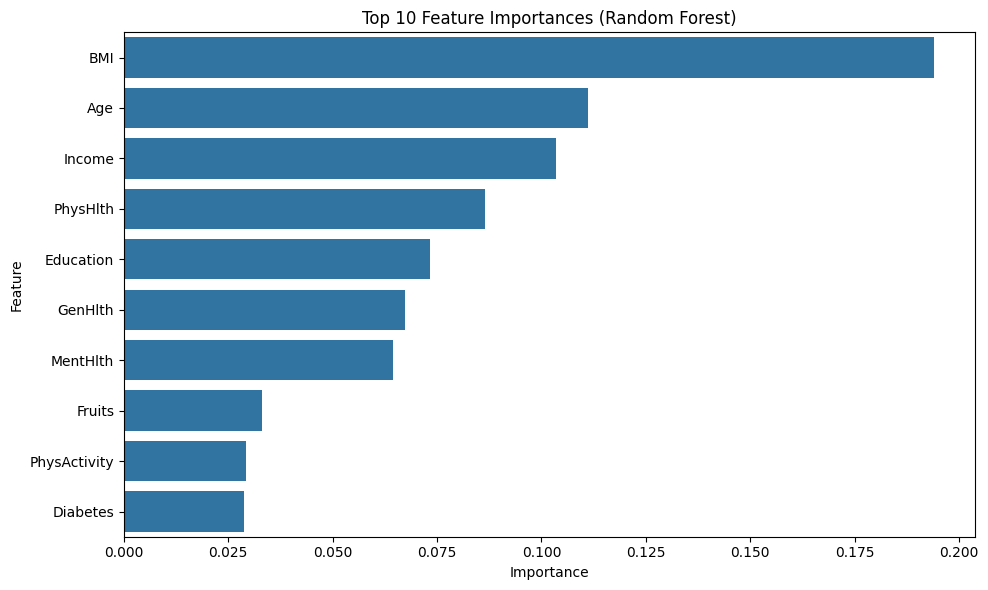

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plot top 10 feature importances
feature_importances = rf_model.feature_importances_
features = X.columns
importance_df = pd.DataFrame({'Feature': features, 'Importance': feature_importances})
importance_df = importance_df.sort_values(by='Importance', ascending=False).head(10)

plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=importance_df)
plt.title('Top 10 Feature Importances (Random Forest)')
plt.tight_layout()
plt.show()


Step 6 : Visualize the Confusion Matrix

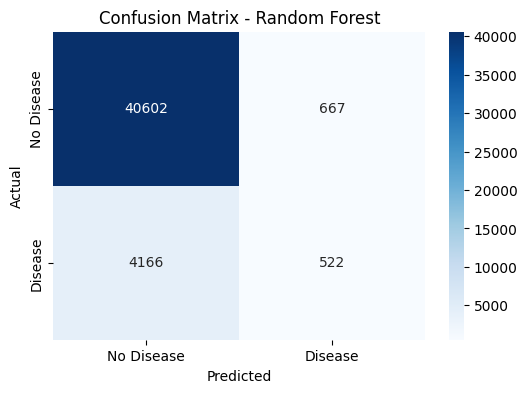

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

# Compute the confusion matrix
rf_cm = confusion_matrix(y_test, rf_predictions)

# Plot it
plt.figure(figsize=(6, 4))
sns.heatmap(rf_cm, annot=True, fmt='d', cmap='Blues', xticklabels=['No Disease', 'Disease'], yticklabels=['No Disease', 'Disease'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix - Random Forest')
plt.show()


- SVM

 Step 1: Define X and y from DataFrame

In [ ]:
# Features and Target
X = df.drop('HeartDiseaseorAttack', axis=1)
y = df['HeartDiseaseorAttack']


Step 2: Train-test split

In [ ]:
from sklearn.model_selection import train_test_split

# 80-20 train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


Step 3: Train the SVM model

In [ ]:
# If your cleaned/preprocessed DataFrame is still called 'df'
# Step 1: Trim the dataset to first 100,000 records
df_trimmed = df.head(100000)

# Step 2: Define X and y
X = df_trimmed.drop('HeartDiseaseorAttack', axis=1)
y = df_trimmed['HeartDiseaseorAttack']

# Step 3: Train-test split
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 4: Take the first 20,000 records from the training set
X_train_subset = X_train.iloc[:20000]
y_train_subset = y_train.iloc[:20000]

# Step 5: Train the SVM with linear kernel
from sklearn.svm import SVC
svm_model = SVC(kernel='linear', probability=True, random_state=42)
svm_model.fit(X_train_subset, y_train_subset)


SVC(kernel='linear', probability=True, random_state=42)

In [ ]:
# Step 1: Extract the next 20,000 training records
X_train_subset2 = X_train.iloc[20000:40000]
y_train_subset2 = y_train.iloc[20000:40000]

# Step 2: Train the SVM model with linear kernel on the new subset
svm_model2 = SVC(kernel='linear', probability=True, random_state=42)
svm_model2.fit(X_train_subset2, y_train_subset2)


SVC(kernel='linear', probability=True, random_state=42)

In [ ]:
# Step 1: Extract the next 20,000 training records
X_train_subset3 = X_train.iloc[40000:60000]
y_train_subset3 = y_train.iloc[40000:60000]

# Step 2: Train the SVM model with linear kernel on this new subset
svm_model3 = SVC(kernel='linear', probability=True, random_state=42)
svm_model3.fit(X_train_subset3, y_train_subset3)


SVC(kernel='linear', probability=True, random_state=42)

In [ ]:
# Step 1: Extract the next 20,000 training records
X_train_subset4 = X_train.iloc[60000:80000]
y_train_subset4 = y_train.iloc[60000:80000]

# Step 2: Train the SVM model with linear kernel on this new subset
svm_model4 = SVC(kernel='linear', probability=True, random_state=42)
svm_model4.fit(X_train_subset4, y_train_subset4)


SVC(kernel='linear', probability=True, random_state=42)

In [ ]:
print("Length of X_train:", len(X_train))



Length of X_train: 80000


Step 4: Predict and Evaluate

In [ ]:
from sklearn.metrics import classification_report, accuracy_score

# Predictions
svm_predictions = svm_model.predict(X_test)

# Evaluation metrics
print("Accuracy:", accuracy_score(y_test, svm_predictions))
print("\nClassification Report:\n", classification_report(y_test, svm_predictions))


Accuracy: 0.8995

Classification Report:
               precision    recall  f1-score   support

         0.0       0.90      1.00      0.95     17990
         1.0       0.00      0.00      0.00      2010

    accuracy                           0.90     20000
   macro avg       0.45      0.50      0.47     20000
weighted avg       0.81      0.90      0.85     20000



/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Step 5: Visualize the Confusion Matrix

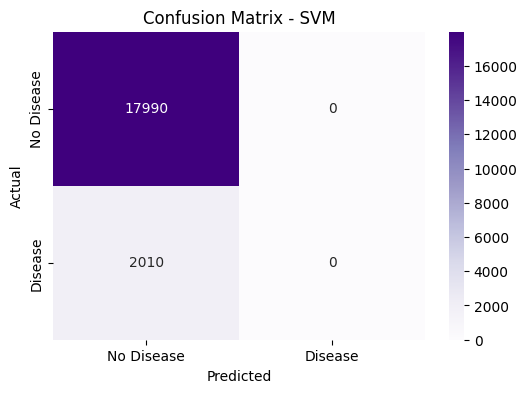

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Confusion Matrix
cm = confusion_matrix(y_test, svm_predictions)

# Plot
plt.figure(figsize=(6,4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Purples',
            xticklabels=['No Disease', 'Disease'],
            yticklabels=['No Disease', 'Disease'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix - SVM')
plt.show()


- COMPARISON

<ipython-input-64-d3ea53d584a1>:26: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=model_names, y=accuracies, palette='viridis')


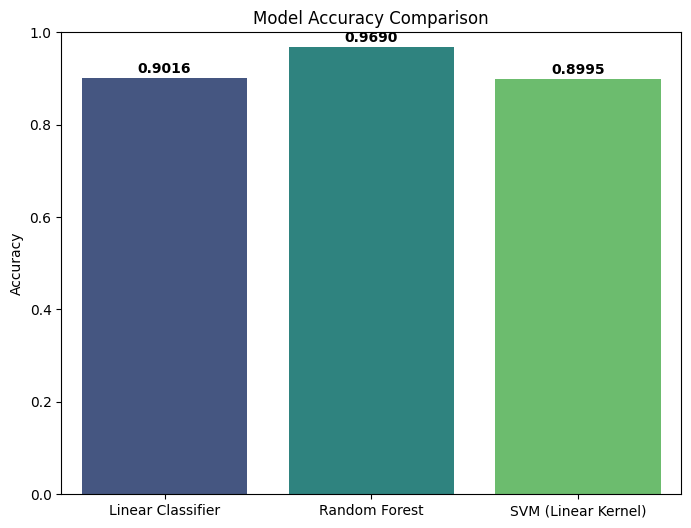

✅ Best Model: Random Forest
🎯 Accuracy: 0.9690


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import accuracy_score

# Make predictions (ensure these models are already trained)
y_pred_linear = linear_model.predict(X_test)
y_pred_rf = rf_model.predict(X_test)
y_pred_svm = svm_model.predict(X_test)  # Change name if you used another variable

# Calculate accuracies
accuracy_linear = accuracy_score(y_test, y_pred_linear)
accuracy_rf = accuracy_score(y_test, y_pred_rf)
accuracy_svm = accuracy_score(y_test, y_pred_svm)

# Prepare data for plotting
model_names = ['Linear Classifier', 'Random Forest', 'SVM (Linear Kernel)']
accuracies = [accuracy_linear, accuracy_rf, accuracy_svm]

# Find the best model
best_index = accuracies.index(max(accuracies))
best_model = model_names[best_index]
best_accuracy = accuracies[best_index]

# Plotting
plt.figure(figsize=(8, 6))
sns.barplot(x=model_names, y=accuracies, palette='viridis')
plt.ylabel('Accuracy')
plt.title('Model Accuracy Comparison')
plt.ylim(0, 1)
for i, v in enumerate(accuracies):
    plt.text(i, v + 0.01, f'{v:.4f}', ha='center', fontweight='bold')
plt.show()

# Print best model info
print(f"✅ Best Model: {best_model}")
print(f"🎯 Accuracy: {best_accuracy:.4f}")

